In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
import os
import math

from PIL import Image

In [3]:
import warnings
warnings.filterwarnings("ignore")
import PIL
PIL.Image.MAX_IMAGE_PIXELS = 933120000

In [8]:
# load evaluation results val. set
df = pd.DataFrame([])

for fold in range(10):
    data = pd.read_csv(f'../eval_results/EVAL_c-kit-mutation_s1/fold_{fold}.csv')
    df = df.append(data)
    
# find false-positives and false negatives
df_false = df.loc[df['Y'] != df['Y_hat']]
df_true = df.loc[df['Y'] == df['Y_hat']]

In [9]:
# sort by false classified with highest confidence

fneg_df = df_false.sort_values(by='p_0').iloc[:10]
fpos_df = df_false.sort_values(by='p_1').iloc[:10]
f_df = pd.concat([fneg_df, fpos_df])
f_df['label'] = f_df['Y'].apply(lambda x: 'POSITIVE' if x == 1 else 'NEGATIVE')

In [10]:
# sort by right classified with highest confidence

tneg_df = df_true.sort_values(by='p_0').iloc[:10]
tpos_df = df_true.sort_values(by='p_1').iloc[:10]
t_df = pd.concat([tneg_df, tpos_df])
t_df['label'] = t_df['Y'].apply(lambda x: 'POSITIVE' if x == 1 else 'NEGATIVE')

In [11]:
f_df.head(21)

,slide_id,Y,Y_hat,p_0,p_1,label
23,CP_MP-21-0009131_L2,0.0,1.0,0.013603,0.986397,NEGATIVE
26,CP_MP-21-0004254_L2,0.0,1.0,0.038321,0.961679,NEGATIVE
32,CP_MP-19-0003053_H2,0.0,1.0,0.057988,0.942012,NEGATIVE
21,CP_IH-21-0013282_H2,0.0,1.0,0.061728,0.938272,NEGATIVE
21,CP_MP-20-0002128_Hsc,0.0,1.0,0.069653,0.930346,NEGATIVE
18,CP_MP-21-0001185_H3,0.0,1.0,0.101315,0.898685,NEGATIVE
32,CP_MP-21-0000705_L2,0.0,1.0,0.108250,0.891750,NEGATIVE
22,CP_MP-21-0000027_H3,0.0,1.0,0.111682,0.888318,NEGATIVE
32,CP_MP-21-0013240_H3,0.0,1.0,0.154616,0.845384,NEGATIVE
23,CP_MP-21-0000588_L2,0.0,1.0,0.165588,0.834412,NEGATIVE


In [12]:
t_df.head(21)

,slide_id,Y,Y_hat,p_0,p_1,label
3,CP_MP-21-0001023,1.0,1.0,0.004083,0.995917,POSITIVE
11,CP_MP-20-0008713,1.0,1.0,0.008612,0.991388,POSITIVE
13,CP_MP-21-0006280,1.0,1.0,0.008875,0.991125,POSITIVE
11,CP_MP-21-0012871,1.0,1.0,0.010519,0.989481,POSITIVE
2,CP_MP-21-0010878,1.0,1.0,0.013603,0.986397,POSITIVE
17,CP_MP-21-0007896 2,1.0,1.0,0.014809,0.985191,POSITIVE
12,CP_MP-20-0014002,1.0,1.0,0.014961,0.985039,POSITIVE
9,CP_MP-21-0003900,1.0,1.0,0.015164,0.984836,POSITIVE
17,CP_MP-20-0002081,1.0,1.0,0.016446,0.983554,POSITIVE
9,CP_MP-21-0006365,1.0,1.0,0.017505,0.982495,POSITIVE


In [13]:
f_df.to_csv('../heatmaps/process_lists/heatmap_ckit_dataset-FP_and_FN.csv')
t_df.to_csv('../heatmaps/process_lists/heatmap_ckit_dataset-TP_and_TN.csv')

## Problems and possible correlations 

- bag size (number of patches)
- morphology of attention maps

## Y: positive, Y_hat: negative 

In [62]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-20-0002008_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-20-0002008_orig_1.jpg')
org = im.resize((1700,1700))

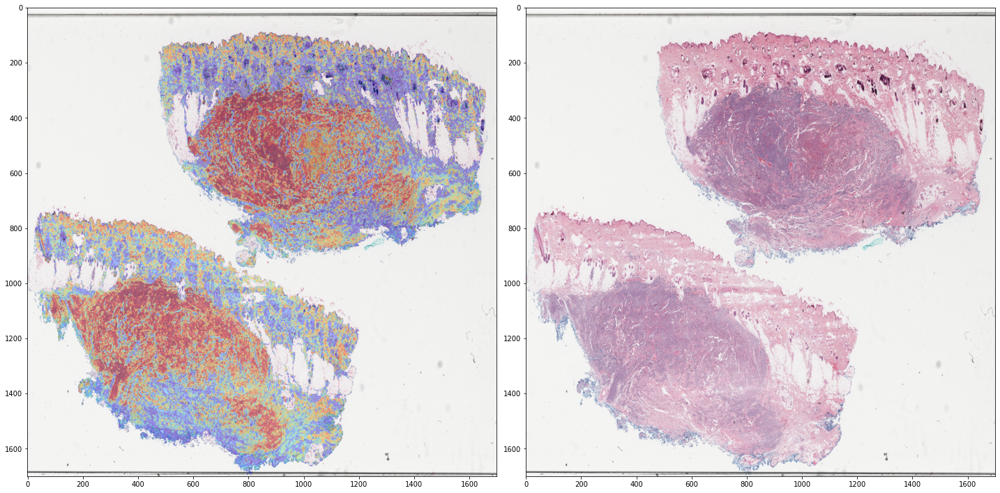

In [63]:
fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

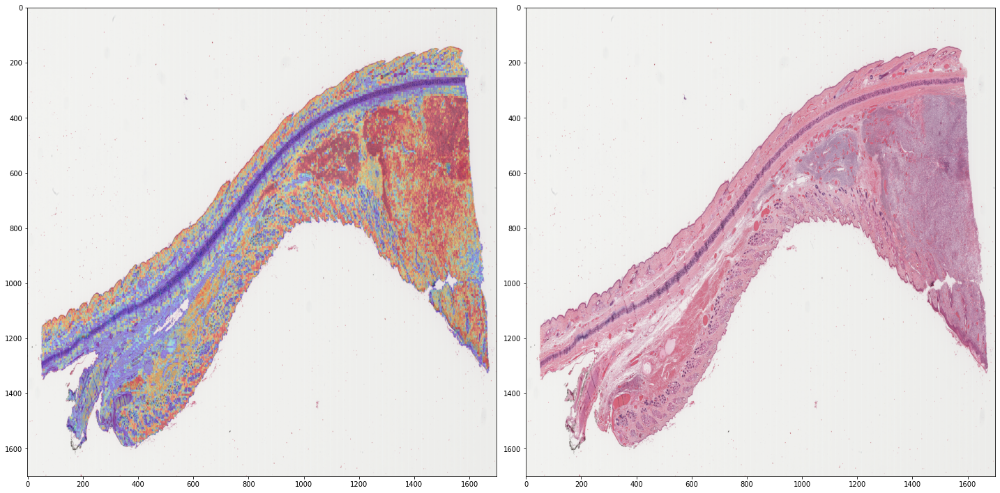

In [64]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-21-0013187_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-21-0013187_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

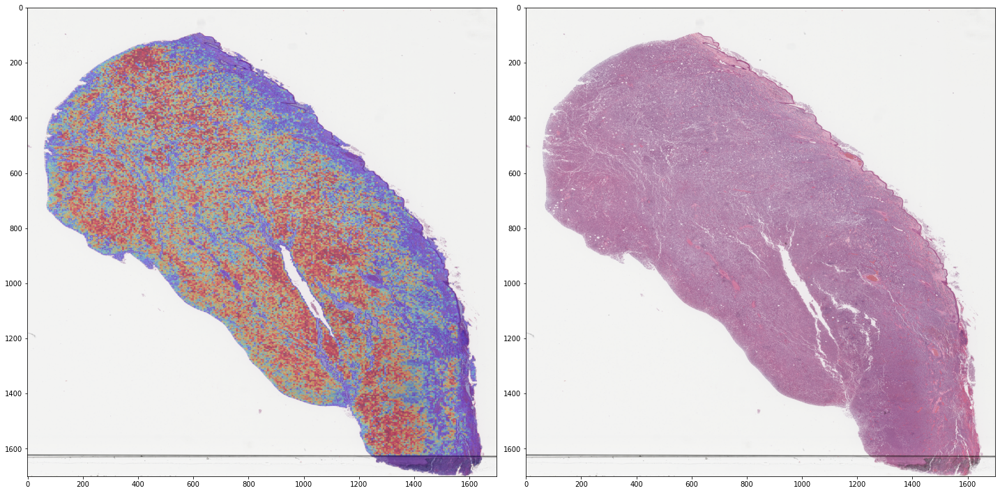

In [71]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-19-0006142_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-19-0006142_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

In [ ]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-19-0006142_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/POSITIVE/CP_MP-19-0006142_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

## Y: negative, Y_hat: positive 

In [58]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0001185_H3_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0001185_H3_orig_1.jpg')
org = im.resize((1700,1700))

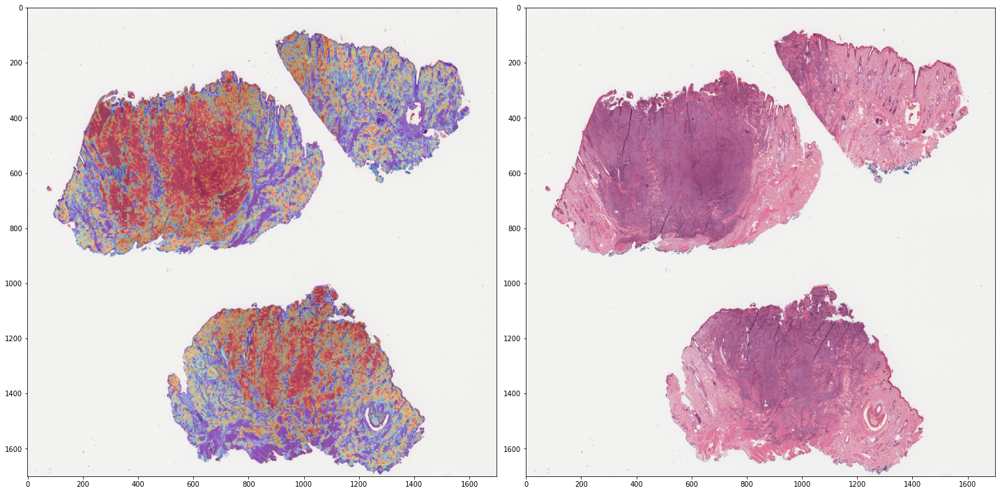

In [59]:
fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

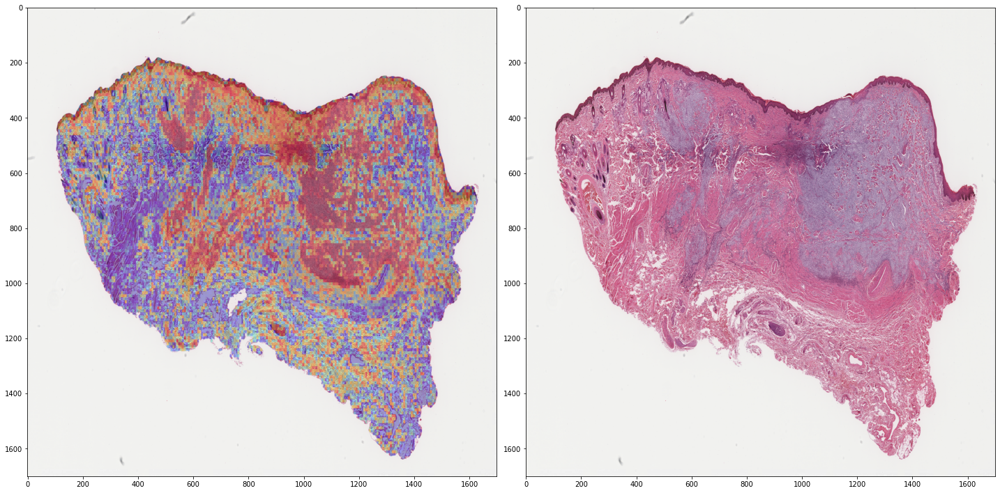

In [65]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0004254_L2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0004254_L2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

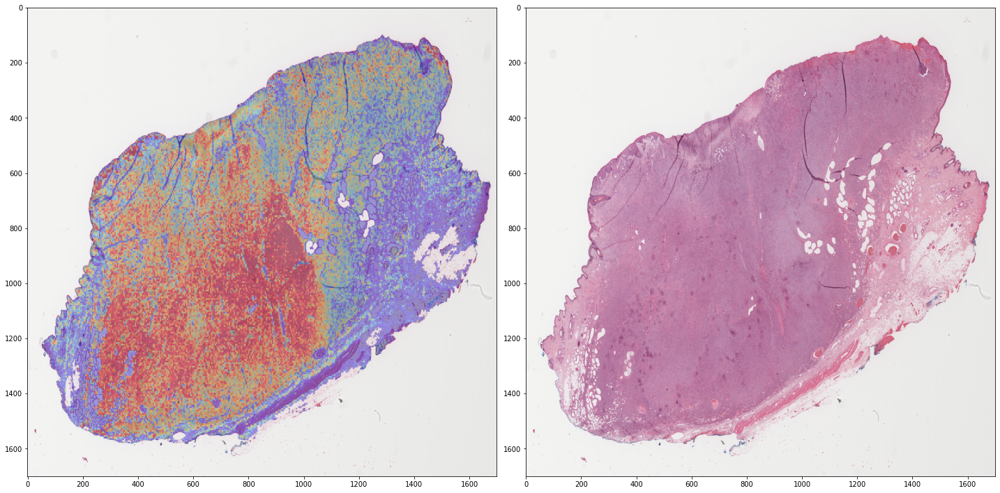

In [72]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0000027_H3_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-21-0000027_H3_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

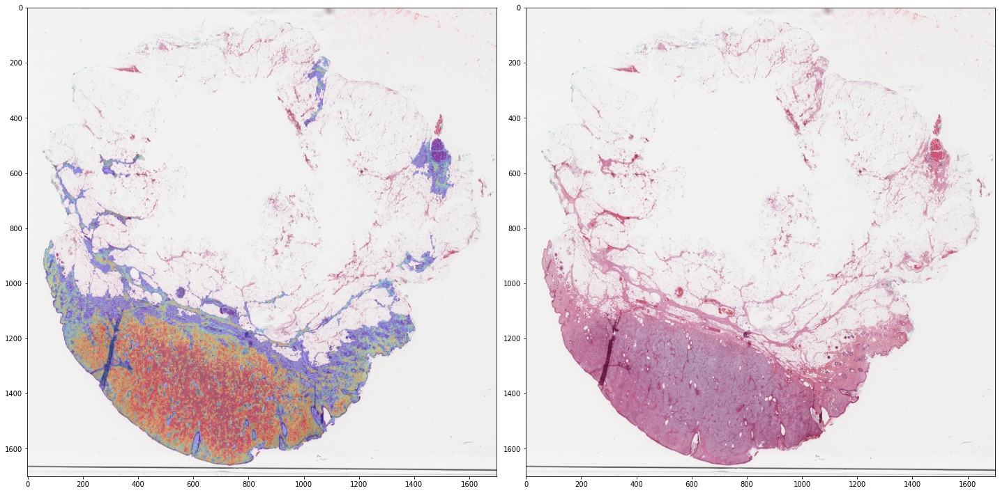

In [8]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-19-0003053_H2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-FP_and_FN/NEGATIVE/CP_MP-19-0003053_H2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

## Y: positive, Y_hat: positive

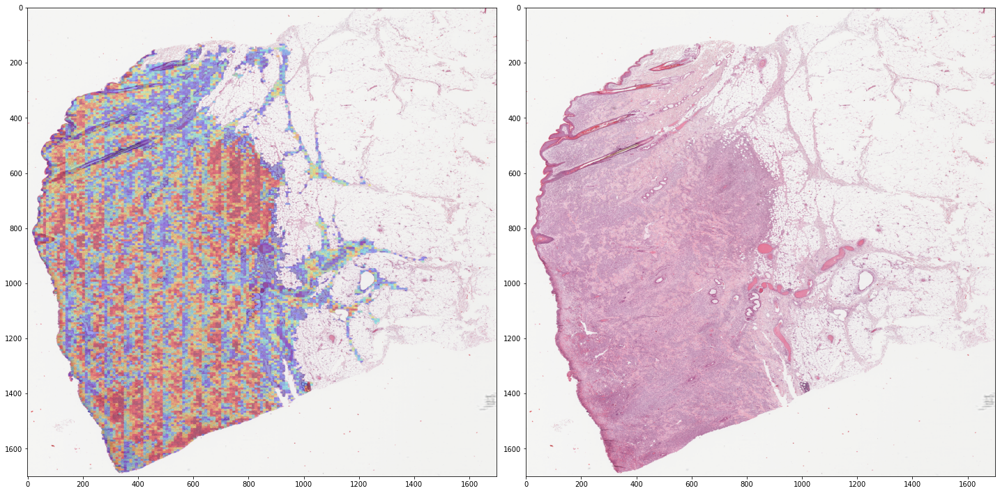

In [66]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0008713_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0008713_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

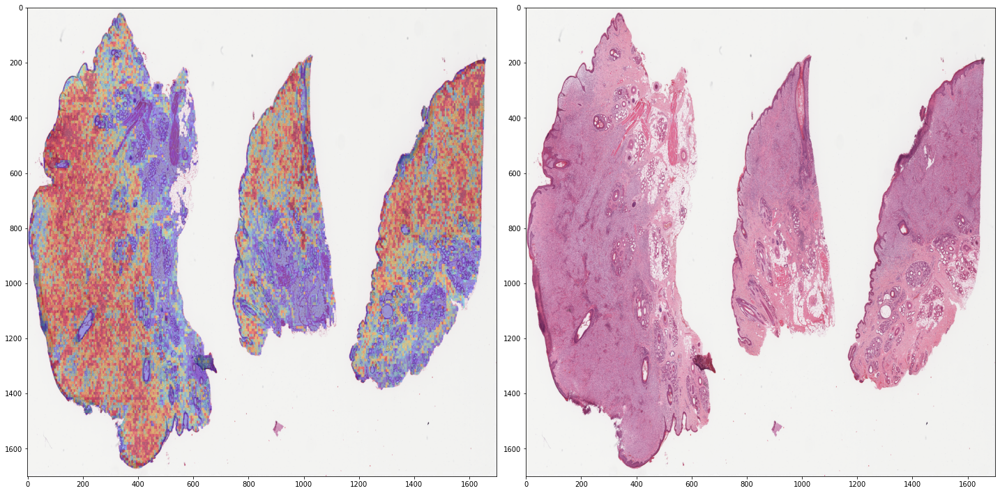

In [68]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0014002_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0014002_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

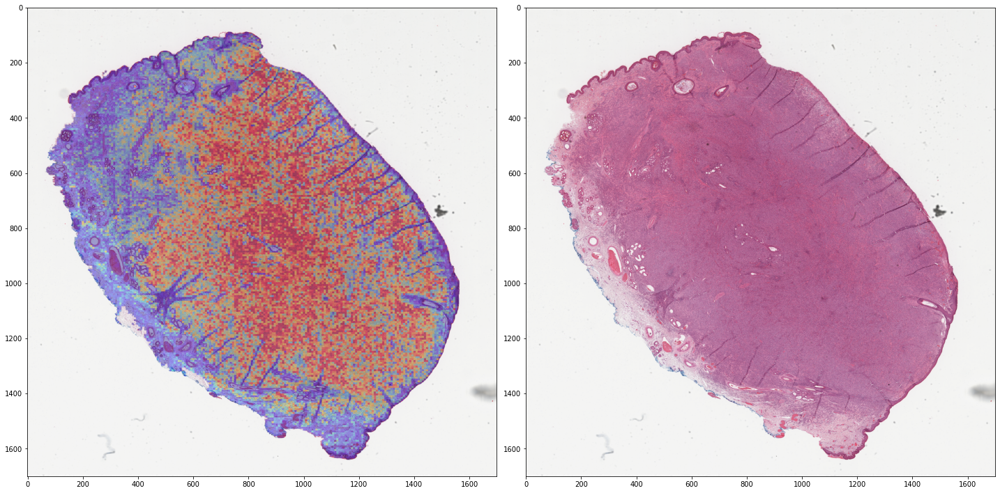

In [69]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0002081_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-20-0002081_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

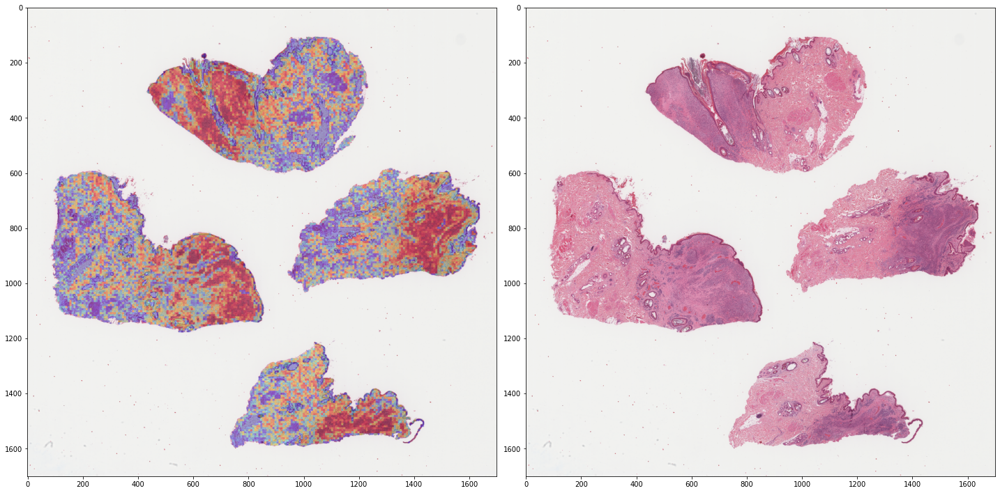

In [70]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-21-0010878_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-21-0010878_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

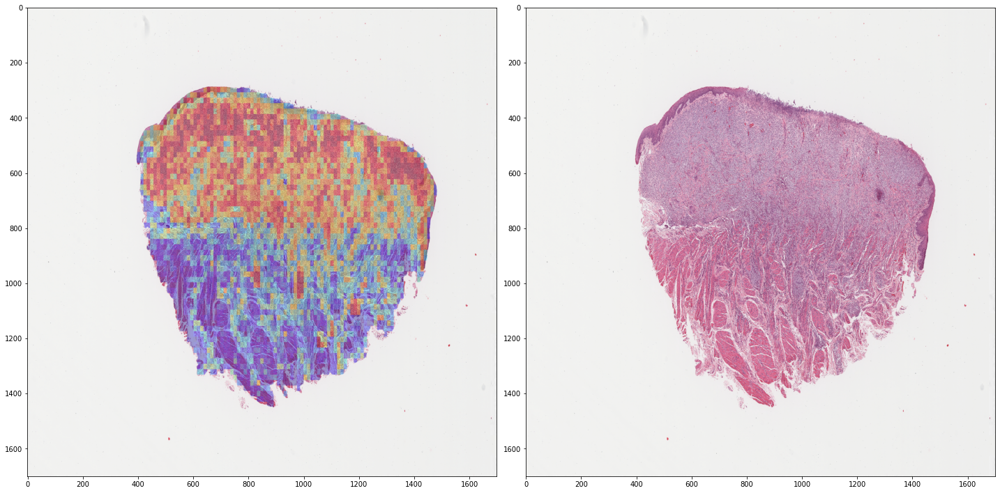

In [6]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-21-0003900_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/POSITIVE/CP_MP-21-0003900_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

## Y: negative, Y_hat: negative


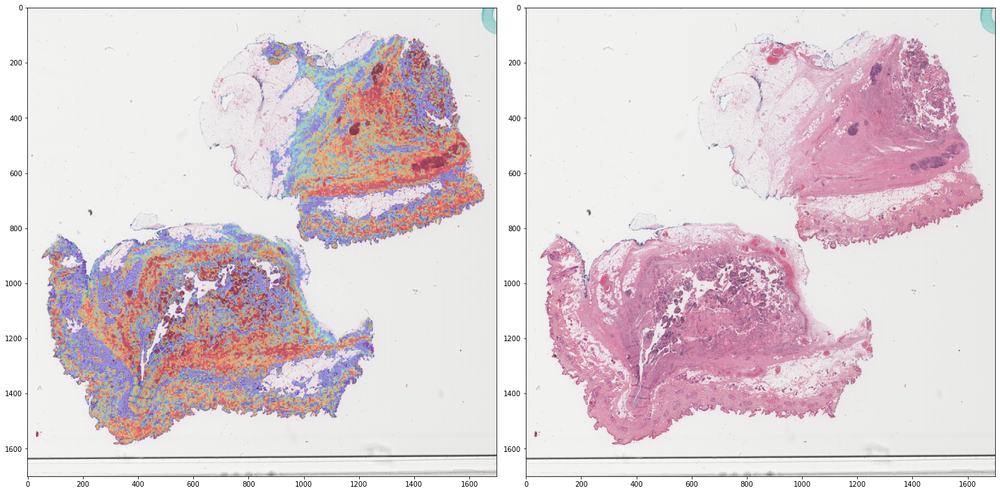

In [73]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0000605_L2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0000605_L2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

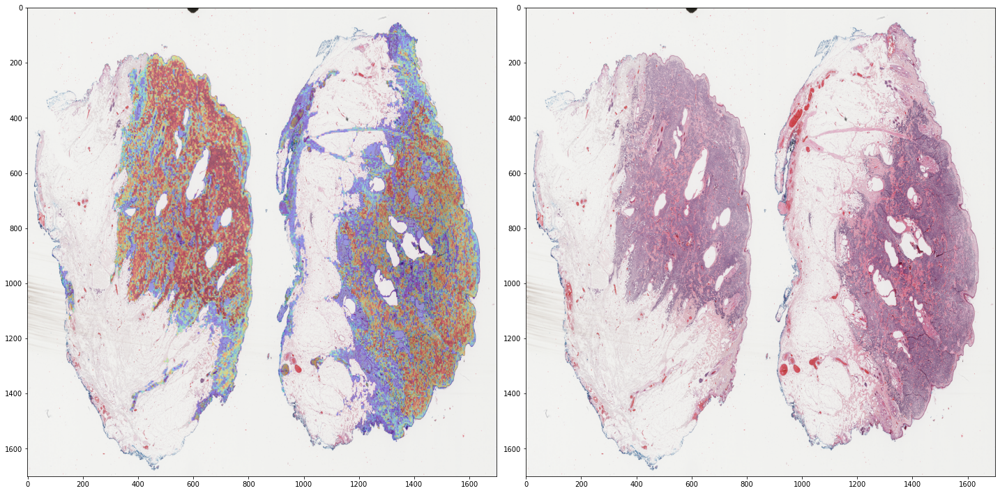

In [74]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-18-0003749_L2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-18-0003749_L2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

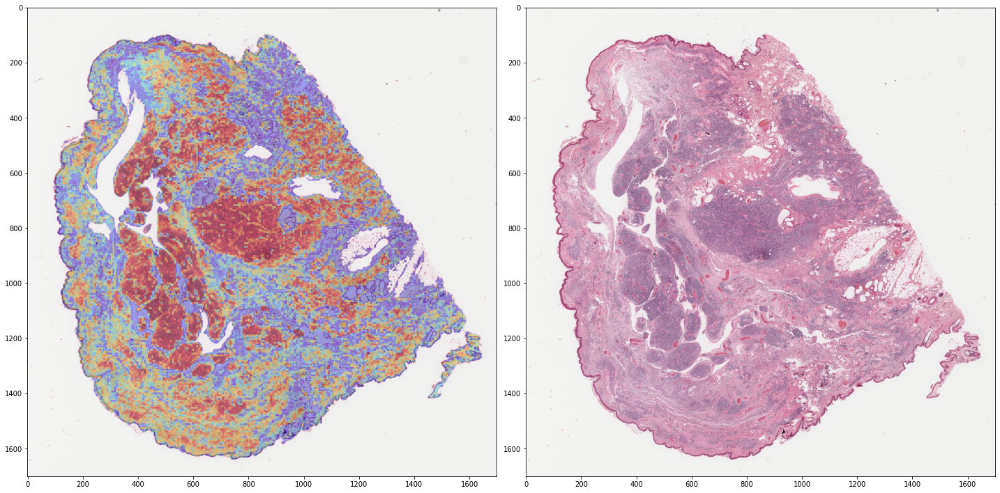

In [75]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0009827_L2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0009827_L2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)

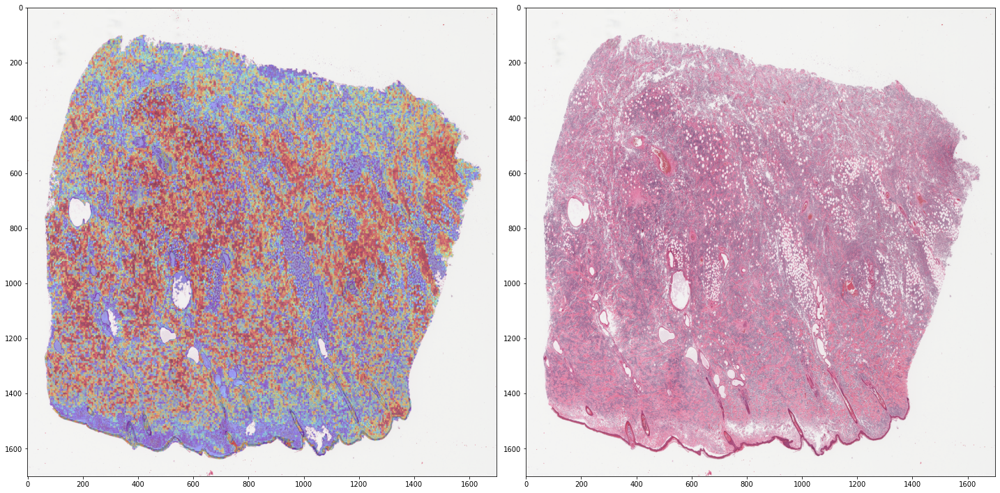

In [5]:
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0007880_H2_0.0_roi_0_blur_0_rs_1_bc_0_a_0.35_l_1_bi_0_-1.0.jpg')
small = im.resize((1700,1700))
im = Image.open('../heatmaps/heatmap_production_results/HEATMAP_OUTPUT_CKIT-TP_and_TN/NEGATIVE/CP_MP-21-0007880_H2_orig_1.jpg')
org = im.resize((1700,1700))

fig, ax = plt.subplots(1,2,figsize=(20,20))
fig.tight_layout()


im_array = np.asarray(small)
ax[0].imshow(im_array)

im_array = np.asarray(org)
ax[1].imshow(im_array)